In [1]:
import datacube
import numpy as np
from deafrica_tools.plotting import rgb, display_map

import datacube
from odc.ui import DcViewer

In [2]:
dc = datacube.Datacube(app="maxar")

In [3]:
product = "maxar_morocco_earthquake_4bands"

measurements = dc.list_measurements()
measurements.loc[product]

,name,dtype,units,nodata,aliases,flags_definition
measurement,,,,,,
ms_analytic_band_B,ms_analytic_band_B,uint16,1,0.0,[ms_analytic_blue],NaN
ms_analytic_band_G,ms_analytic_band_G,uint16,1,0.0,[ms_analytic_green],NaN
ms_analytic_band_R,ms_analytic_band_R,uint16,1,0.0,[ms_analytic_red],NaN
ms_analytic_band_N,ms_analytic_band_N,uint16,1,0.0,[ms_analytic_nir08],NaN
pan_analytic,pan_analytic,uint16,1,0.0,[pan],NaN
visual_band_R,visual_band_R,uint8,1,0.0,[visual_red],NaN
visual_band_G,visual_band_G,uint8,1,0.0,[visual_green],NaN
visual_band_B,visual_band_B,uint8,1,0.0,[visual_blue],NaN


In [4]:
product = "maxar_morocco_earthquake_8bands"

measurements = dc.list_measurements()
measurements.loc[product]

,name,dtype,units,nodata,aliases,flags_definition
measurement,,,,,,
ms_analytic_band_C,ms_analytic_band_C,uint16,1,0.0,[ms_analytic_coastal],NaN
ms_analytic_band_B,ms_analytic_band_B,uint16,1,0.0,[ms_analytic_blue],NaN
ms_analytic_band_G,ms_analytic_band_G,uint16,1,0.0,[ms_analytic_green],NaN
ms_analytic_band_Y,ms_analytic_band_Y,uint16,1,0.0,[ms_analytic_yellow],NaN
ms_analytic_band_R,ms_analytic_band_R,uint16,1,0.0,[ms_analytic_red],NaN
ms_analytic_band_RE,ms_analytic_band_RE,uint16,1,0.0,[ms_analytic_rededge],NaN
ms_analytic_band_N,ms_analytic_band_N,uint16,1,0.0,[ms_analytic_nir08],NaN
ms_analytic_band_N2,ms_analytic_band_N2,uint16,1,0.0,[ms_analytic_nir09],NaN
pan_analytic,pan_analytic,uint16,1,0.0,[pan],NaN


In [5]:
lat = 31.6427
lon = -8.0640
buffer = 0.01

time = '2023'

In [6]:
DcViewer(dc=dc,
         products=('maxar_morocco_earthquake_4bands','maxar_morocco_earthquake_8bands'),
         time=time,
         center=(lat, lon),
         zoom=17)

In [7]:
display_map((lon-buffer, lon+buffer),(lat-buffer, lat + buffer))

In [8]:
ds_2 = dc.load(product="maxar_morocco_earthquake_8bands",
             measurements=['visual_band_R',
                          'visual_band_B',
                          'visual_band_G'],
             time=time, 
             x= (lon-buffer, lon+buffer),
             y = (lat-buffer, lat + buffer)
            )

ds_2

<xarray.Dataset>
Dimensions:        (time: 9, y: 4752, x: 4077)
Coordinates:
  * time           (time) datetime64[ns] 2023-01-24T11:31:45 ... 2023-09-10T1...
  * y              (y) float64 3.502e+06 3.502e+06 3.502e+06 ... 3.5e+06 3.5e+06
  * x              (x) float64 5.878e+05 5.878e+05 ... 5.897e+05 5.897e+05
    spatial_ref    int32 32629
Data variables:
    visual_band_R  (time, y, x) uint8 28 39 84 103 95 87 ... 130 135 145 142 140
    visual_band_B  (time, y, x) uint8 27 36 76 92 82 72 ... 100 101 108 105 104
    visual_band_G  (time, y, x) uint8 23 35 79 98 91 80 ... 105 108 116 113 116
Attributes:
    crs:           epsg:32629
    grid_mapping:  spatial_ref

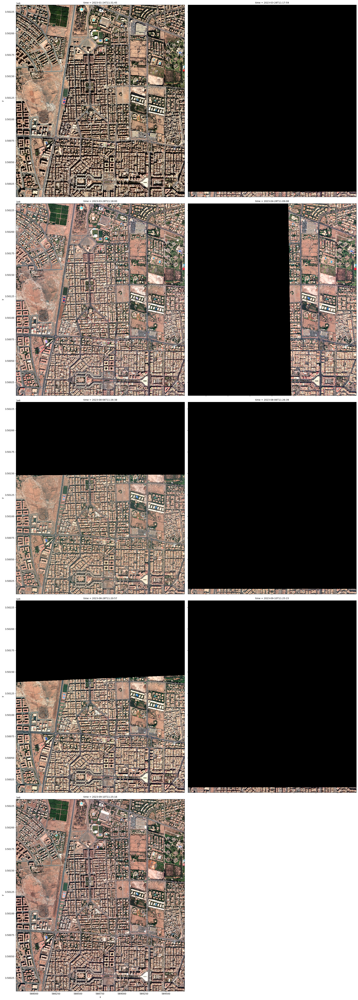

In [9]:
rgb(ds_2, bands=["visual_band_R", "visual_band_G", "visual_band_B"], col='time', size=12, col_wrap=2)